In [20]:
# İmport Libraries
# - tensorflow 2.0 import
%tensorflow_version 2.x
import tensorflow as tf

# - download and import mitdeeplearn
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Other packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

#assert len(tf.config.list_physical_devices('GPU')) > 0

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [21]:
#Download dataset
songs = mdl.lab1.load_training_data()

example_song = songs[0]
print("\nExample Song: ")
print(example_song)

Found 817 songs in text

Example Song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


In [22]:
len(songs[0])

252

In [23]:
#Convert The ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

In [24]:
# şimdi liste halindeki song dizilerini alt alta tanımlayalım
songs_joined = "\n\n".join(songs)

# şimdi birleştirdiğimiz verilerdeki tüm benzersiz karakterleri ayıklayalım
vocab = sorted(set(songs_joined))
print("Verisetimizde toplam ",len(vocab),"birbirinden farklı karakter var")

Verisetimizde toplam  83 birbirinden farklı karakter var


In [25]:
# RNN modelimiz için dizideki karakterleri sayılara dönüştürmekle başlıyoruz
#iki adımlı olacak birinci adım karakterleri sayıya çevirecek
# ikinci adım sayıları karakterlere çevirecek (tahminde bulunulan sayıyı karaktere tekrar çevirmek için kullanacaz)

#1 .adım
char2idx = {u:i for i,u in enumerate(vocab)}

# 2.adım
idx2char = np.array(vocab)

In [26]:
# şimdi bir bakalım her eşsiz karaktermize bir sayı atandı
print("{")
for char,_ in zip(char2idx,range(20)):
  print("    {:4s}:{:3d},".format(repr(char),char2idx[char]))
print(" .....\n}")

{
    '\n':  0,
    ' ' :  1,
    '!' :  2,
    '"' :  3,
    '#' :  4,
    "'" :  5,
    '(' :  6,
    ')' :  7,
    ',' :  8,
    '-' :  9,
    '.' : 10,
    '/' : 11,
    '0' : 12,
    '1' : 13,
    '2' : 14,
    '3' : 15,
    '4' : 16,
    '5' : 17,
    '6' : 18,
    '7' : 19,
 .....
}


In [27]:
# şimdi tüm şarkı dizisini vectorize edecez yani sayılarla ifade edeceğiz bunun için bir fonksiyon yazalım
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [28]:
#bir bakalım
print("{}-----------characters mapped to int------------> {}".format(repr(songs_joined[:10]),vectorized_songs[:10]))

'X:1\nT:Alex'-----------characters mapped to int------------> [49 22 13  0 45 22 26 67 60 79]


In [29]:
vectorized_songs.shape[0]

200679

## EĞİTİM İÇİN UYGUN BÖLME VE SHAPE İŞLEMLERİ YAPALIM
## BATCH AND SHAPE

In [30]:
# Eğitim örneklerini ve hedeflerini oluşturacaz
#metni eğitimde kullanmak için böleceğiz
def get_batch(vectorized_songs,seq_length,batch_size):
  #sayılara çevrilmiş ses dizilerinin uzunluğu
  n = vectorized_songs.shape[0]-1
  #eğitim kümesindeki örnekler için başlangıç indexlerini rastgele seçmek için;
  idx = np.random.choice(n-seq_length,batch_size) # (hangi sayılar arasından,kaç adet)

  # Eğitim grubu için girdi dizileriniN LİSTESİNİ OLUŞTURALIM
  input_batch =   [vectorized_songs[i:i+seq_length] for i in idx]

  # eğitim grubu için çıktı dizilerini oluşturalım
  output_batch = [vectorized_songs[i+1:i+seq_length+1] for i in idx]

  #ağ eğitimi için doğru girdileri sağlayalım yeniden şekillendirelim
  x_batch = np.reshape(input_batch , [batch_size,seq_length])
  y_batch = np.reshape(output_batch,[batch_size,seq_length])
  return x_batch,y_batch



In [31]:
test_args = get_batch(vectorized_songs,10,2)
test_args

(array([[59, 27, 82, 58, 26, 31, 26,  1, 32, 16],
        [31, 32,  1, 30, 15, 22, 82,  2,  0, 31]]),
 array([[27, 82, 58, 26, 31, 26,  1, 32, 16, 22],
        [32,  1, 30, 15, 22, 82,  2,  0, 31, 82]]))

In [32]:
x_batch,y_batch = get_batch(vectorized_songs,5,1)
for i,(input_idx,target_idx) in enumerate(zip(np.squeeze(x_batch),np.squeeze(y_batch))):
  print("Step {:3d}".format(i))
  print(" İnput : {} ({:s})".format(input_idx,repr(idx2char[input_idx])))
  print("  Expected Output : {} ({:s})".format(target_idx,idx2char[target_idx]))

Step   0
 İnput : 59 ('d')
  Expected Output : 58 (c)
Step   1
 İnput : 58 ('c')
  Expected Output : 26 (A)
Step   2
 İnput : 26 ('A')
  Expected Output : 1 ( )
Step   3
 İnput : 1 (' ')
  Expected Output : 32 (G)
Step   4
 İnput : 32 ('G')
  Expected Output : 31 (F)


## AĞ İÇİN GİRİŞ ÇIKIŞ PARÇALARINI AYARLADIK ŞİMDİ RNN MODELİMİZİ KURALIM

In [33]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences = True,
      recurrent_initializer="glorot_uniform",
      recurrent_activation="sigmoid",
      stateful=True,
  )

In [34]:
# modelimizi inşa edelim
def build_model(vocab_size,embedding_dim,rnn_units,batch_size):
  model = tf.keras.Sequential([
      tf.keras.layers.Embedding(vocab_size,embedding_dim,batch_input_shape = [batch_size,None]),
      LSTM(rnn_units),
      tf.keras.layers.Dense(vocab_size)
  ])

  return model

model = build_model(len(vocab),embedding_dim = 256,rnn_units = 1024,batch_size = 32)

In [35]:
#modelimizin giriş çıkış shape kontrolu yapalım
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (32, None, 256)           21248     
                                                                 
 lstm_1 (LSTM)               (32, None, 1024)          5246976   
                                                                 
 dense_1 (Dense)             (32, None, 83)            85075     
                                                                 
Total params: 5353299 (20.42 MB)
Trainable params: 5353299 (20.42 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


**-----------------HIZLI BİR DENEME YAPALIM-------------**

In [36]:
x,y = get_batch(vectorized_songs,seq_length=100,batch_size = 32)
pred = model(x)
print("Input Shape : ",x.shape,"##(batch_size,sequence_length)")
print("Prediction Shape : ",pred.shape ,"##(batch_size,sequence_length,vocab_size)")

Input Shape :  (32, 100) ##(batch_size,sequence_length)
Prediction Shape :  (32, 100, 83) ##(batch_size,sequence_length,vocab_size)


In [37]:
sampled_indices = tf.random.categorical(pred[0],num_samples = 1)
sampled_indices = tf.squeeze(sampled_indices,axis  = -1).numpy()
sampled_indices

array([58, 52, 77, 70, 73, 34, 31, 29, 24, 53,  3, 29,  6, 34, 13, 81, 40,
       63,  1, 68, 22, 32, 38, 73, 80, 34, 74, 62,  4, 46, 50,  7, 69, 41,
        1, 54, 37, 35, 57, 40,  0, 35, 18, 57, 43, 23, 47, 44, 39, 64, 75,
       14,  4, 76, 22, 38,  0, 33, 77,  2, 70, 59, 34, 33, 43, 73, 34, 39,
       36, 44, 29,  1,  8,  5, 20,  9, 32, 36,  0, 77, 45, 23, 27, 51, 63,
       62, 33, 16, 17, 57, 45,  3, 70, 15, 27, 81,  6, 82,  8, 35])

In [38]:
#modelimiz daha eğitimsiz bu eğitimsiz modelin verdiği indexlerin ne tahmin ettiğini görmek için decode edelim
print("Input   \n",repr("".join(idx2char[x[0]])))
print()
print(" Next Char Predictions : \n ",repr("".join(idx2char[sampled_indices])))

Input   
 'Sheemore\nZ: id:dc-ocarolan-14\nM:3/4\nL:1/8\nK:D Major\nde|f2 fe d2|d3 e d2|B4 A2|F4 A2|BA Bc d2|e4 de|f'

 Next Char Predictions : 
  'c[vorIFD=]"D(I1zOh m:GMryIsg#UY)nP ^LJbO\nJ6bR<VSNit2#u:M\nHv!odIHRrINKSD ,\'8-GK\nvT<BZhgH45bT"o3Bz(|,J'


In [43]:
#şimdi makinemizi eğitme işlemi yapalım
#Eğitme için kayıp hesaplayıp makineye ne kadar kaybı olduğunu söylememiz gerekir
# SPARSE CATEGORİCAL CROSSETNROPY KULLANMAMIZIN SEBEİ TAM SAYI OLAN BİR SINIFLANDIRMA ETİKETLEME OLMASINDANDIR
# ONE HOT ENCODİNG LABELLER İÇİN CATEGORİCAL_CROSSENTROPY KULLANMAK UYGUN OLUR

def compute_loss(labels,logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels,logits,from_logits = True)
  return loss

#kayıp fonskiyonunu deneyelim
example_batch_loss = compute_loss(y,pred)

print("Prediction shape",pred.shape,"##---(batch_size,seq-length,vocab_size)")
print("Scalar Loss" , example_batch_loss.numpy().mean())

Prediction shape (32, 100, 83) ##---(batch_size,seq-length,vocab_size)
Scalar Loss 4.4184566


In [44]:
#şimdi  modelimizin eğitimi için hiperparametreleri optimize edicileri tanımlayalım

# OPTİMİZASYON PARAMETRELERİ
learning_rate = 5e-3
batch_size = 4
num_training_iterations = 2000 #epoch
seq_length = 100

# model parametreleri
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024

#checkpoinr locations
checkpoint_dir = "./training_checkpoints"
checkpoint_prefix = os.path.join(checkpoint_dir,"my_ckpt")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


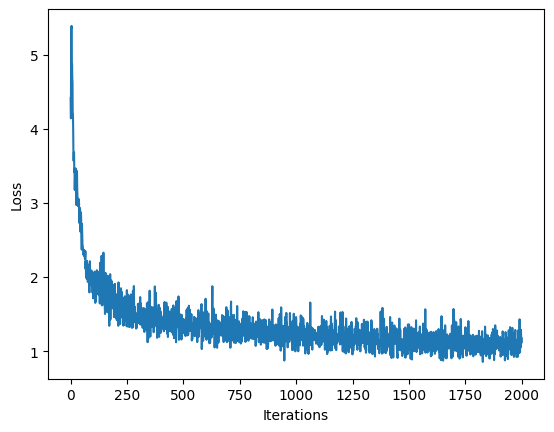

100%|██████████| 2000/2000 [2:19:27<00:00,  4.18s/it]


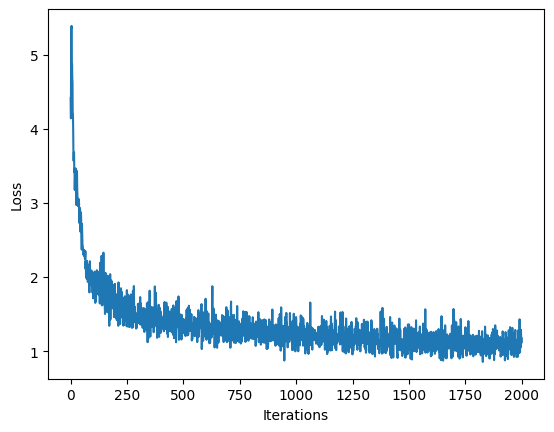

In [46]:
#şimdi modeli eğitmeye başlıyoruz
# optimize ediciler Adam ve Adagrad
# model ve optimizer başlatacağız
# geri yayılma işlemleri için GradientTape çalıştıracağız
# modelin kaydettiği ilerlemeyi kaydedeceğiz

#1-modeli yapılandır
model = build_model(vocab_size,embedding_dim,rnn_units,batch_size)

# 2- optimizer başlat
optimizer = tf.keras.optimizers.Adam(learning_rate)


##########################------------EĞİTİM------------##############
@tf.function

def train_step(x,y):

  with tf.GradientTape() as tape:  #gradient hesaplamak için

    y_hat = model(x)                # tahmin yapıyoruz

    loss = compute_loss(y,y_hat)     # kayıp hesaplıyoruz

    grads = tape.gradient(loss,model.trainable_variables)  # kayıp fonksiyonunun model parametreleri üzerindeki gradientini hesapla

    optimizer.apply_gradients(zip(grads,model.trainable_variables))  #optimizer kullanarak modelin parametrelerini güncelliyoruz

    return loss


###################-----------------EĞİTİM BAŞLASIN----------------###########################

history = []  # eğitim sırasında kaybedilen kayıpları depolamak için liste oluşturduk
plotter = mdl.util.PeriodicPlotter(sec = 2,xlabel = "Iterations",ylabel = "Loss")  #loss değerlerini belirle aralıkla grafiğe çizmek için bir çizim aracı oluşturur
if hasattr(tqdm,"_instances"):tqdm._instances.clear()                   #  Eğer tqdm ilerleme çucuğu varsa temizle


for iter in tqdm(range(num_training_iterations)):   #belirlemiş olduğumuz iterasyon sayısına göre döngü başlatıyoruz

  x_batch,y_batch = get_batch(vectorized_songs,seq_length,batch_size)  # giriş ve etiketlerini tanımlıyoruz

  loss = train_step(x_batch,y_batch)    # kaybı hesaplayıp optimize işlemlerini uyguluyoruz

  history.append(loss.numpy().mean())  # kayıpları history listesine ekliyoruz

  plotter.plot(history) # kayıpları çizilmek üzere grafik oluşurucumuza veriliyor

  if iter % 100  == 0 :
    model.save_weights(checkpoint_prefix)  #her 100 iterasyonda modelin ağırlıkları checkpoint_prefix e kaydedilir

model.save_weights(checkpoint_prefix)  #eğitim tamamlandıktan sonra eğitilmiş modelin ağırlıkları checkpoint prefix e kaydedilir sonra kullanılmak için



## PREDİCT

In [47]:
# modeli eğitip ağırlıkları kaydettik
#tahmin işlemi için başlangıç string vermemiz gerekiyor ki düzeni anlayıp ona göre tahminde bulunsun
#RNN durumundan her zaman adımından diğerine aktarılacağı için batch_size = 1 olarak ayarlanacaktır

# modelimizi yeniden inşa edelim
model = build_model(vocab_size,embedding_dim,rnn_units,batch_size = 1)

#son kontrol noktasındaki ağırlıkları yükleyelim
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1,None]))
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_3 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_3 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5353299 (20.42 MB)
Trainable params: 5353299 (20.42 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [48]:
# bir başlangıç dizisi vereceğiz ve rnn başlatacağız
def generate_text(model,start_string,generation_length):

  # başlangıçta verilen diziyi sayısal değerlere çevirelim
  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval,0)  #bir boyut ekliyoruz

  # üretilen stringleri depolayacağımız liste
  text_generated = []

  model.reset_states()      # durumları resetlioruz
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):   # üretim uzunluğu yani epoch döngüsünü başlatıyoruz
    predictions = model(input_eval)   #tahmini yaptık

    predictions = tf.squeeze(predictions,0)   #boyutlarını sıkıştırdık teke indirdik

    prediction_idx = tf.random.categorical(predictions,num_samples = 1)[-1,0].numpy() #multinominal dağılımı kullanarak bir örnek index seçer diğer zaman adımına girecek indexi seçer sonundaki [-1,0] bir örnek seçildiğini belirtir

    input_eval = tf.expand_dims([prediction_idx],0)  # Tahmin edilen karakteri bir sonraki girş için bir önceki giriş dizine ekler

    text_generated.append(idx2char[prediction_idx]) #Tahmin edilen karakteri listemize ekler

  return (start_string + "".join(text_generated))  ############ burası önemli çıktı diğer zaman adımında girdi oluyor

In [49]:
generated_text = generate_text(model,start_string = "X",generation_length=1000) #modelimizi başlatıyoruz

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
100%|██████████| 1000/1000 [00:21<00:00, 47.09it/s]


## ÜRETİLEN ABC NOTASYONUNU ÇALMA

In [54]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text) #ABC notasyonundan anlamlı dize özetleri çıkarmak için kullanıyoruz

for i , song in enumerate(generated_songs):
  waveform = mdl.lab1.play_song(song)


  if waveform :
    print("Generated_Song" , i)
    ipythondisplay.display(waveform)

Found 5 songs in text
Generated_Song 2


Generated_Song 3


Generated_Song 4
